In [ ]:
import pims
import matplotlib.pyplot as plt
import numpy as np
import trackpy as tp
import scipy.optimize as optimization
import pandas as pd
import math
from scipy import asarray as ar,exp
saveloc = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\features overnight masscut\\\\"
location = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\images overnight\\"

class particle_class():
    def __init__(self, Id, xpos, ypos, zpos):
        self.identity = Id
        self.posx = xpos
        self.posy = ypos
        self.posz = zpos
        self.neigbour_list = []
    def get_x(self):
        return self.posx
    def get_y(self):
        return self.posy
    def get_z(self):
        return self.posz
    def add_neigbour(self, neigbour):
        self.neigbour_list.append(neigbour)
    def get_neigbour(self):
        return self.neigbour_list
    def get_id(self):
        return self.identity

True

In [ ]:
'''
Find connectivity through time
'''
# init
particlesFoundList = []
meanNeigbourList = []
maxNeigbourList = []
minNeigbourList = []
histList = []
fBefore = []
fAfter = []
massCutoff = []
succes = []
failed = []

# loop trough doList range
doList = [i for i in range(79,80)]
print(doList)

for item in doList:
    # Initialize
    histListPerTimeFrame = []
    
    # load located features
    features = pd.read_pickle(saveloc+'features_'+str(item)+'.pkl')
    print("loaded")
    
    # add found to list
    particlesFound = len(features)
    particlesFoundList.append(particlesFound)

    # Rezise particles radius
    features['z'] = (features['z'])*0.6
    features['x'] = (features['x'] / 1024)*105.77
    features['y'] = (features['y'] / 1024)*105.77

    # define cutoff
    cutoff = 5.0 # micro meters

    # Create particles class
    particles = []
    for index, row in features.iterrows():
        newparticle = particle_class(index, row['x'], row['y'], row['z'])
        particles.append(newparticle)

    # calculate connectivity 
    total = 0
    Max = 0
    Min = 100
    total_dis = []

    print("Particles created, start loop")
    # loop over all particles
    for particle in particles:      
        # first find all neigbours
        for neigbour in particles:  
            # dont add yourself as neibour
            if (neigbour.get_id() != particle.get_id()):            
                distance = (math.pow(particle.get_x() - neigbour.get_x(),2) + 
                            math.pow(particle.get_y() - neigbour.get_y(),2) + 
                            math.pow(particle.get_z() - neigbour.get_z(),2))

                # check if between cutoff
                if(math.sqrt(distance) < cutoff):
                    total_dis.append(math.sqrt(distance))
                    particle.add_neigbour(neigbour)
                    total+=1
        if (len(particle.get_neigbour()) > Max):
            Max = len(particle.get_neigbour())
        if (len(particle.get_neigbour()) < Min):
            Min = len(particle.get_neigbour())


    meanTotal = 0
    for particle in particles:
        amountNeigbours = len(particle.get_neigbour())
        meanTotal += amountNeigbours
        histListPerTimeFrame.append(amountNeigbours)
    histList.append(histListPerTimeFrame)
    meanNeigbourList.append(meanTotal / particlesFound)
    maxNeigbourList.append(Max)
    minNeigbourList.append(Min)

Frame([[[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       ..., 
       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 
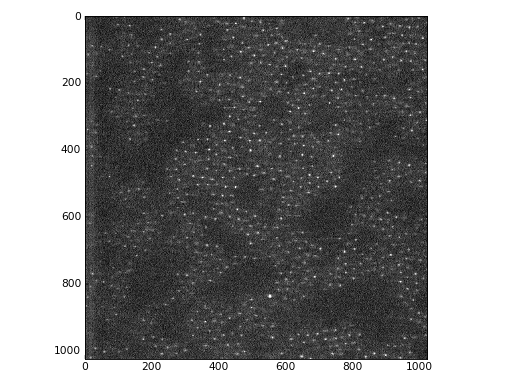
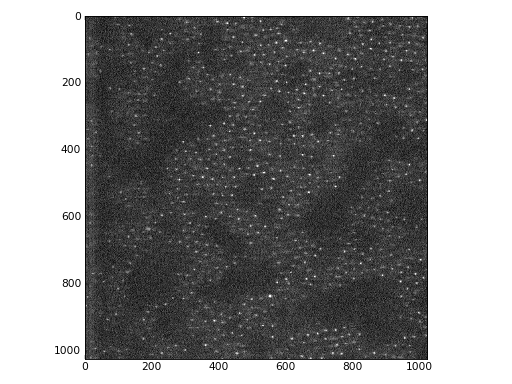
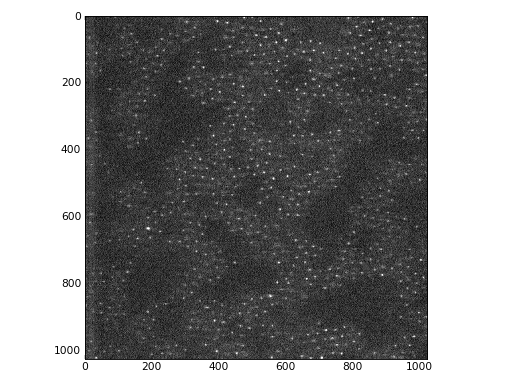
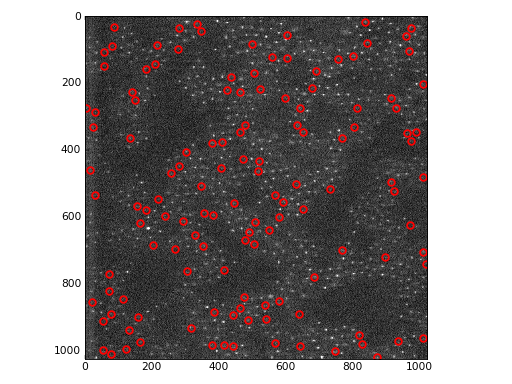
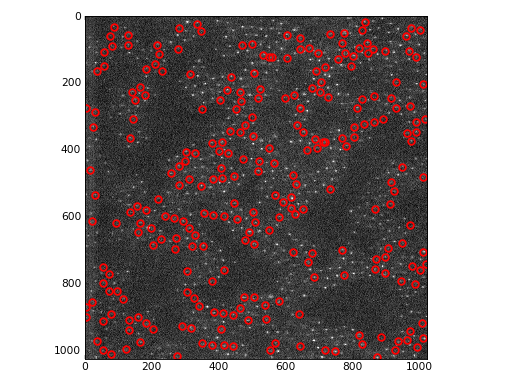
...
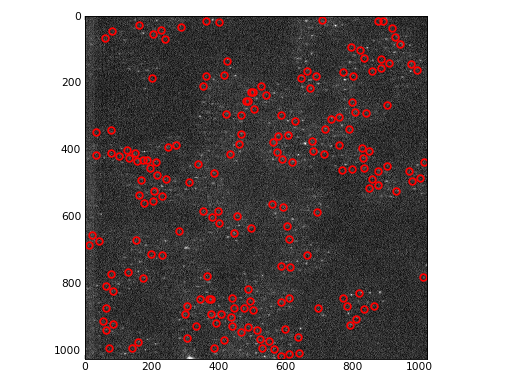
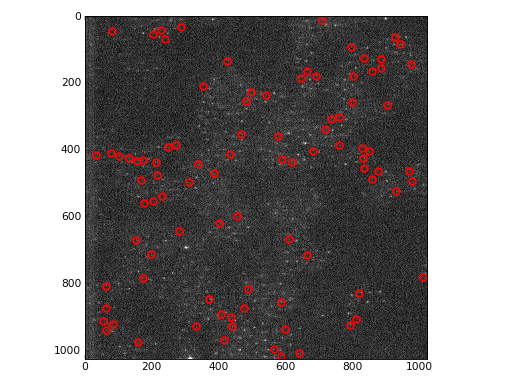
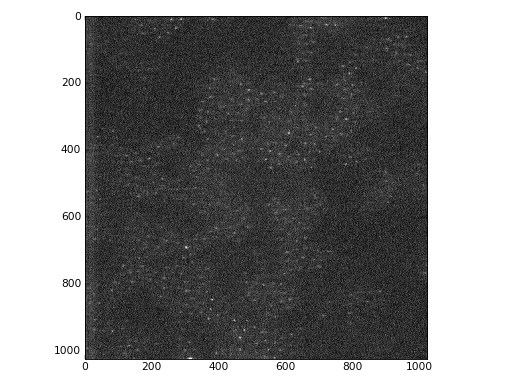
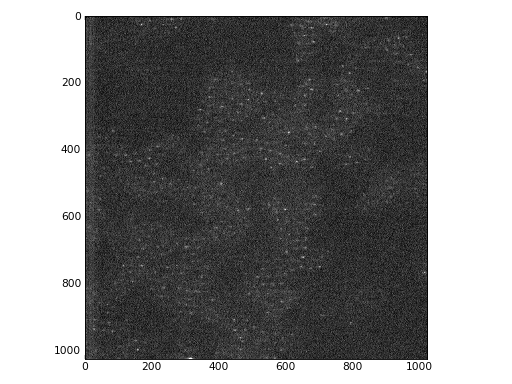
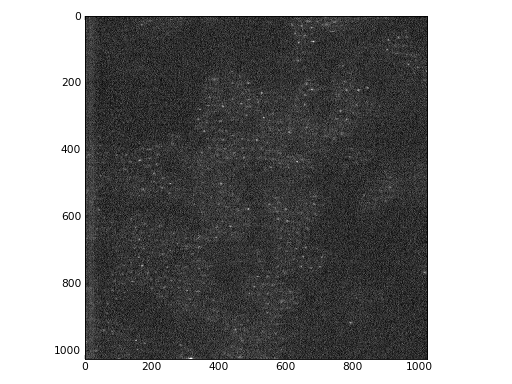

In [7]:
import trackpy as tp
import numpy as np
import pandas as pd
import pims
saveloc = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\features overnight masscut\\\\"
location = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\images overnight\\"

i=79
image = pims.Bioformats("E:\Stephan Bachelorproject\\20160627_long_3045.mdb\\stephan28overnight.lsm");
features = pd.read_pickle(saveloc+'features_'+str(i)+'.pkl')
tp.plots.annotate3dStephan(features, image[79],Vmin=0, Vmax = 100,plot_style={"marker":"."} ,invert =False)

Frame([[[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       ..., 
       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 
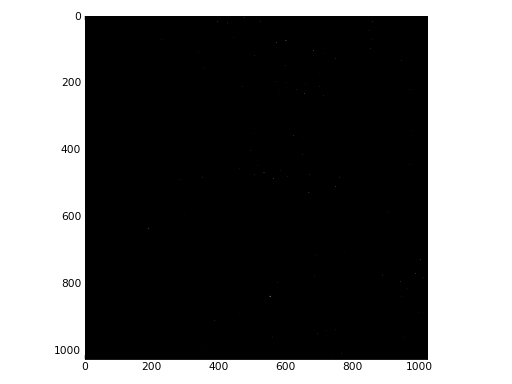
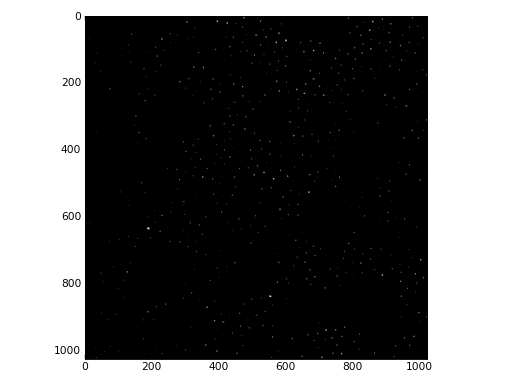
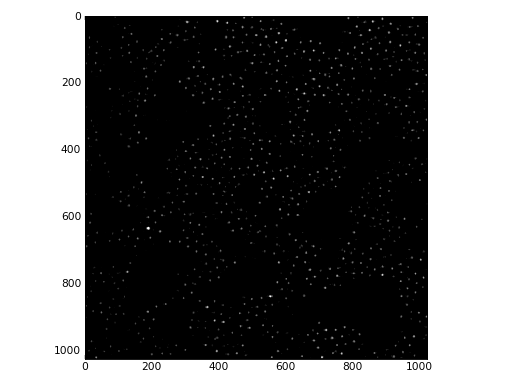
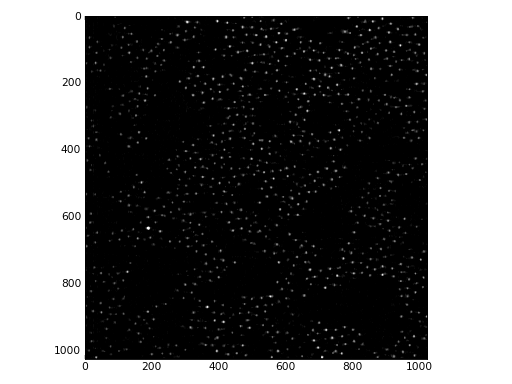
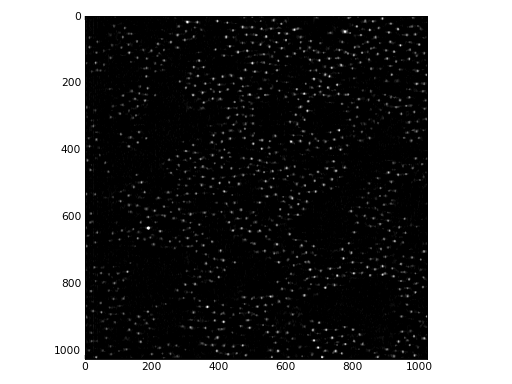
...
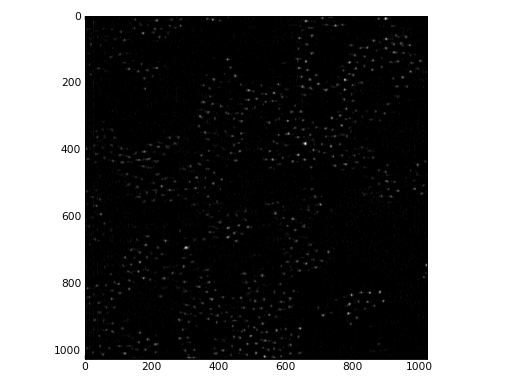
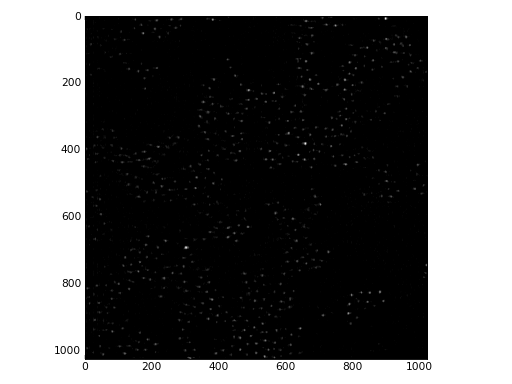
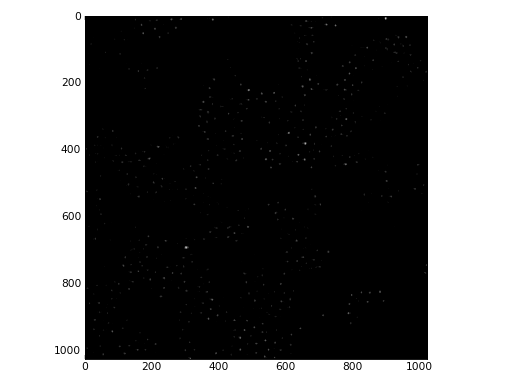
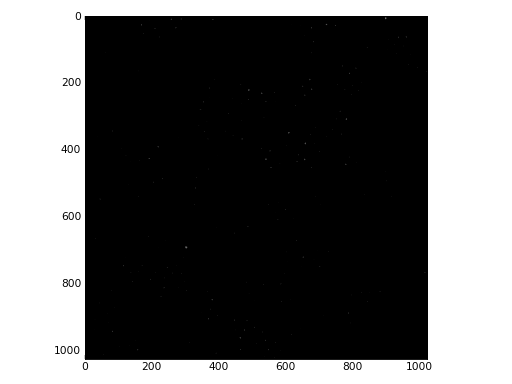
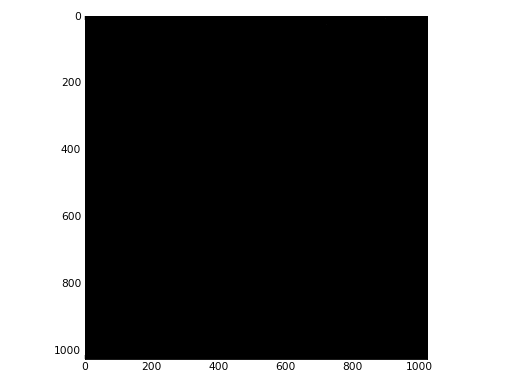

In [3]:
import trackpy as tp
import numpy as np
import pandas as pd
saveloc = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\features overnight masscut\\\\"
location = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\images overnight\\"

i=79
image = np.load(location + 'image_' + str(i) + '.npy')
features = pd.read_pickle(saveloc+'features_'+str(i)+'.pkl')
features = features[features['mass']>99999]
tp.plots.annotate3dStephan(features, image,Vmin=0, Vmax = 100,plot_style={"marker":"."} ,invert =False)

2957


Frame([[[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       ..., 
       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 
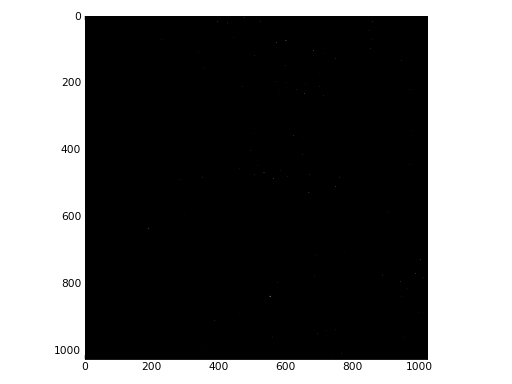
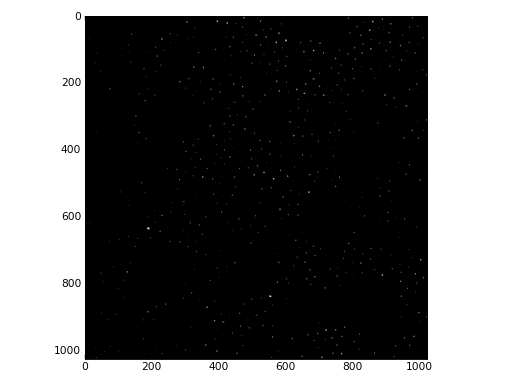
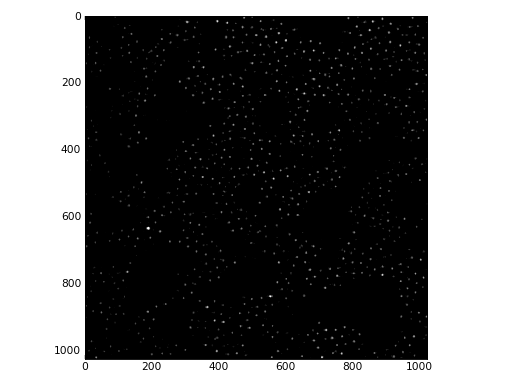
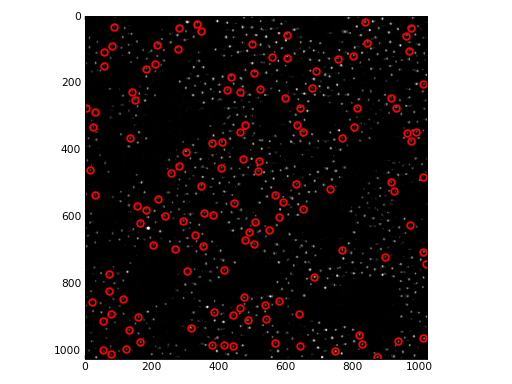
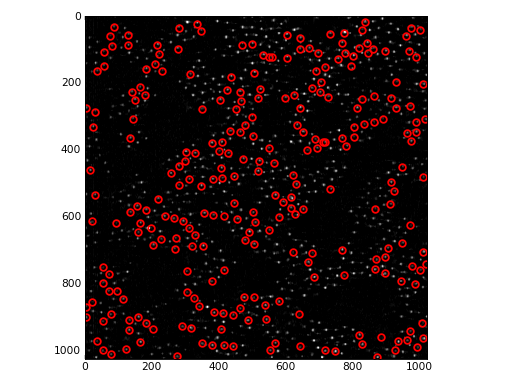
...
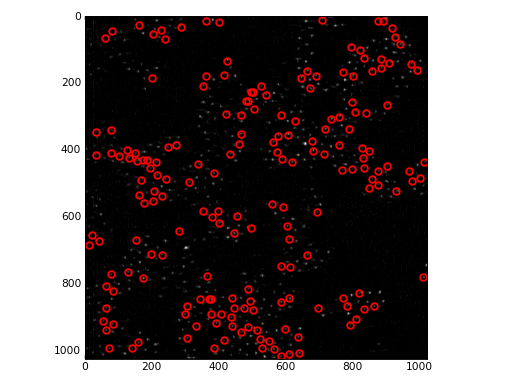
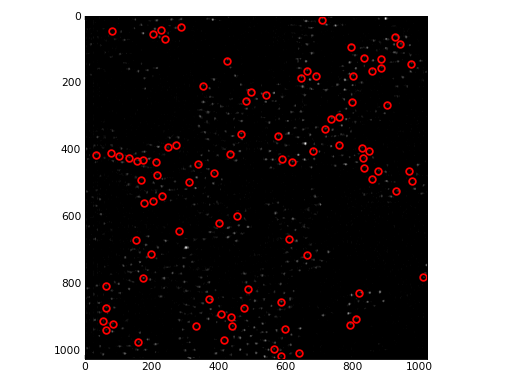
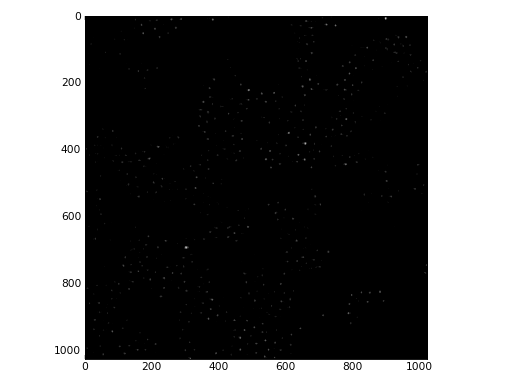
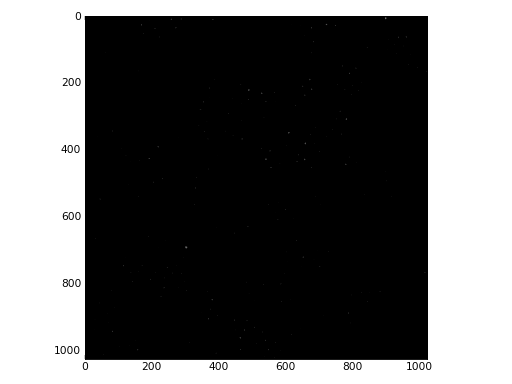
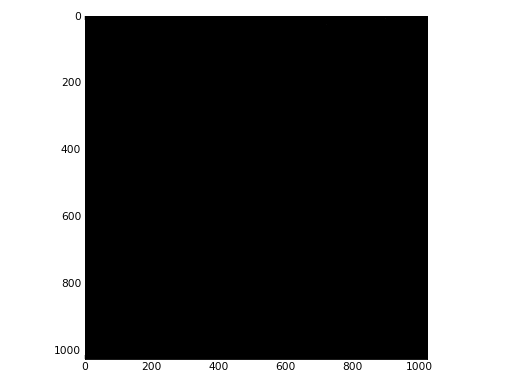

In [1]:
import trackpy as tp
import numpy as np
import pandas as pd
saveloc = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\features overnight masscut\\\\"
location = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\images overnight\\"

i=79
image = np.load(location + 'image_' + str(i) + '.npy')
features = pd.read_pickle(saveloc+'features_'+str(i)+'.pkl')
print(len(features))
tp.plots.annotate3dStephan(features, image,Vmin=0, Vmax = 100,plot_style={"marker":"."} ,invert =False)

2330


Frame([[[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        ..., 
        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]]],


       ..., 
       [[[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         ..., 
         [255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 255, 255]],

        [[255, 255, 255, 255],
         [255, 255, 255, 255],
         [255, 255, 
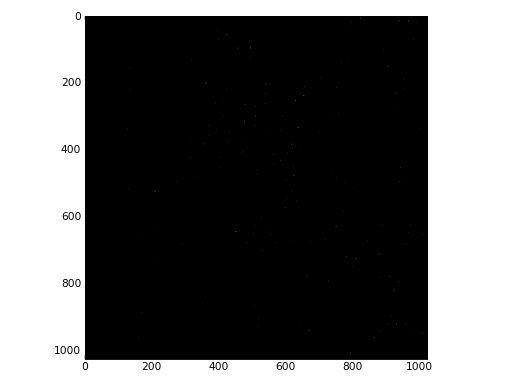
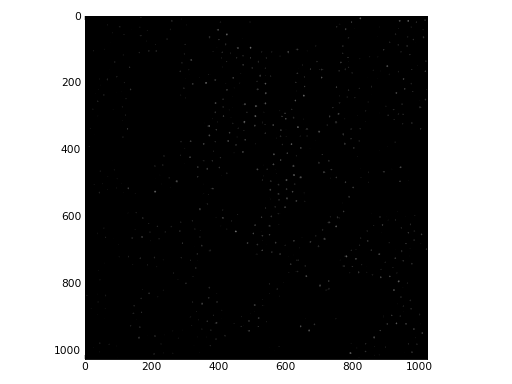
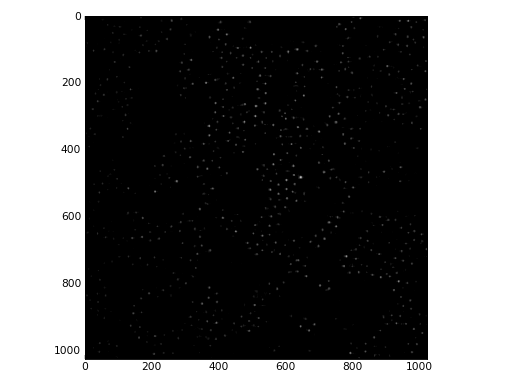
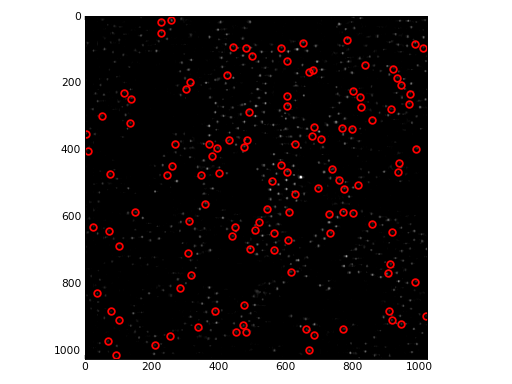
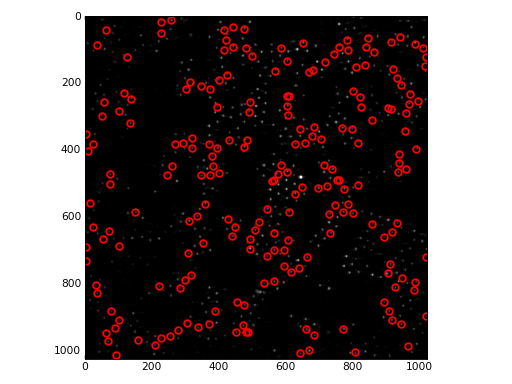
...
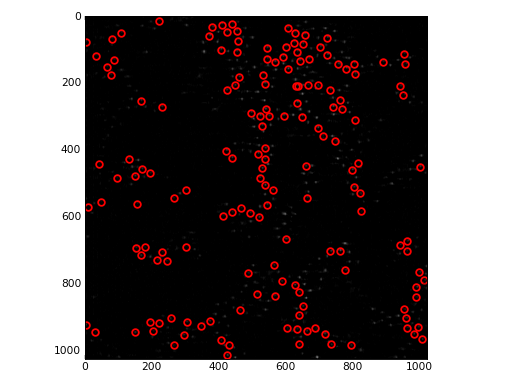
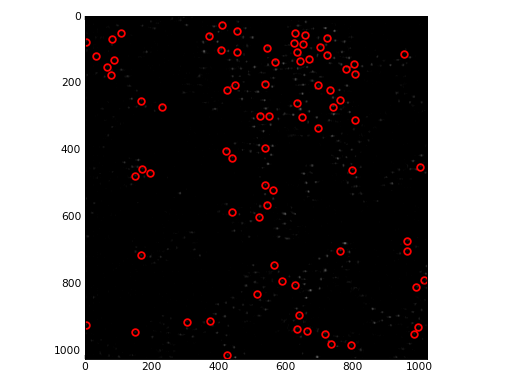
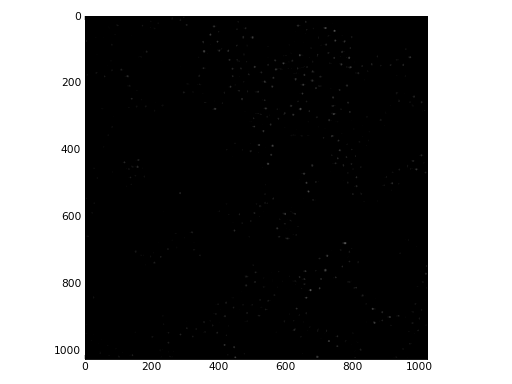
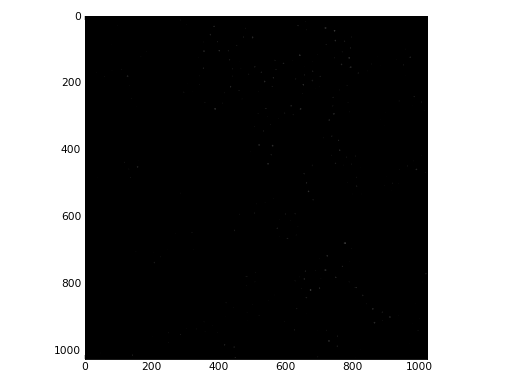
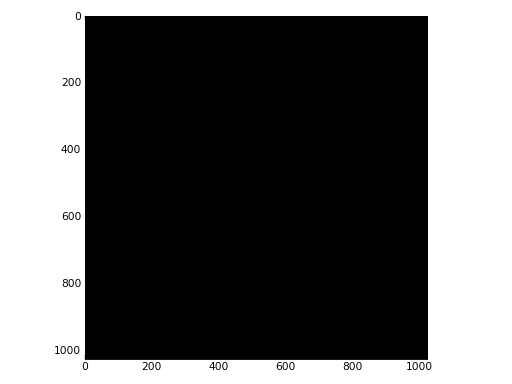

In [2]:
import trackpy as tp
import numpy as np
import pandas as pd
saveloc = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\features overnight masscut\\\\"
location = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\images overnight\\"

i=0
image = np.load(location + 'image_' + str(i) + '.npy')
features = pd.read_pickle(saveloc+'features_'+str(i)+'.pkl')
print(len(features))
tp.plots.annotate3dStephan(features, image,Vmin=0, Vmax = 100,plot_style={"marker":"."} ,invert =False)

In [ ]:
import trackpy as tp
import numpy as np
import pandas as pd
saveloc = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\features overnight\\\\"
location = "E:\\Stephan Bachelorproject\\20160627_long_3045.mdb\\images overnight\\"

i=0
image = np.load(location + 'image_' + str(i) + '.npy')
features = pd.read_pickle(saveloc+'features_'+str(i)+'.pkl')
print(len(features))
tp.plots.annotate3dStephan(features, image,Vmin=0, Vmax = 100,plot_style={"marker":"."} ,invert =False)

In [ ]:
i=0
image = np.load(location + 'image_' + str(i) + '.npy')
features = pd.read_pickle(saveloc+'features_'+str(i)+'.pkl')
tp.annotate3d(features, image,invert=True)

In [ ]:
i=0
image = np.load(location + 'image_' + str(i) + '.npy')
tp.annotate3d(features2, image)

In [ ]:

y, x = np.histogram(features['mass'], bins = 200)
x=x[1:]

temp = 0
for i in range(0, len(y)):
    if(temp < y[i]):
        temp=y[i]
        tempAnswer=i

counts=y[tempAnswer]
for i in range(tempAnswer+1,len(x)):
    if(y[i] < counts):
        counts = y[i]
        massCutoff = x[i]
    else:
        break
features2 = features[features['mass'] > massCutoff*0.5]

plt.hist(features2['mass'],bins=500)
plt.show()

In [ ]:
# import time
# plt.clf()
# plt.figure()
# plt.show()
# print(succes)
# for item in range(0, len(succes)):
#     plt.hist(histList[item], bins = range(0,maxNeigbourList[item]),
#              alpha=0.2, label="time " + str(item) + ", particles " + str(particlesFoundList[item]))
#     plt.legend()
#     plt.draw()
#     time.sleep(0.5)
    


In [ ]:
plt.clf()
print(succes)
for item in succes[:-1]:
    plt.hist(histList[item], bins = maxNeigbourList[item], 
             alpha=0.5, label="time " + str(item) + ", particles " + str(particlesFoundList[item]))
plt.legend()
plt.show()

In [ ]:
fBefore[0]

In [ ]:
meanNeigbourList

In [ ]:
features = pd.read_pickle(FEATURESLOC+'frame_'+str(100)+'.pkl')
tp.annotate3d(features, np.load('D:\\bachelorproject\\3dmetingimages\\image_100.npy'))

In [ ]:
features = pd.read_pickle(FEATURESLOC+'frame_'+str(100)+'.pkl')
features = features.nlargest(2500, 'mass')
tp.annotate3d(features, np.load('D:\\bachelorproject\\3dmetingimages\\image_100.npy'))

In [ ]:
features = pd.read_pickle(FEATURESLOC+'frame_'+str(0)+'.pkl')
features = features.nlargest(2500, 'mass')
tp.annotate3d(features, np.load('D:\\bachelorproject\\3dmetingimages\\image_0.npy'))

In [ ]:
8*0.6